<a href="https://colab.research.google.com/github/gokulelangovan/DLA/blob/master/Detectron2_PubLayNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8MB 24kB/s 
     |████████████████████████████████| 6.6MB 3.5MB/s 
  Found existing installation: torch 1.6.0+cu101
    Uninstalling torch-1.6.0+cu101:
      Successfully uninstalled torch-1.6.0+cu101
  Found existing installation: torchvision 0.7.0+cu101
    Uninstalling torchvision-0.7.0+cu101:
      Successfully uninstalled torchvision-0.7.0+cu101
     |████████████████████████████████| 276kB 8.9MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp36-cp36m-linux_x86_64.whl size=44075 sha256=d604ba4da79aea072907e2b5e2e095f978d607f5407b3981bbc06dbd6d6652e2
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-

In [2]:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
     |████████████████████████████████| 6.2MB 958kB/s 
  Created wheel for fvcore: filename=fvcore-0.1.2.post20201030-cp36-none-any.whl size=44294 sha256=7ddfda5d9bf5e1ed8c7e748cbef0ee80388a0f5f849005b3af9febf79f60bcd5
  Stored in directory: /root/.cache/pip/wheels/7f/7a/c8/521a7c1d1974bf1c536fed7cb258e3be173730d71065407bab
Successfully built fvcore


In [1]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

In [2]:
!curl -L "https://app.roboflow.com/ds/cMcpy3prsu?key=R4jDtYzGR6" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   887  100   887    0     0   1293      0 --:--:-- --:--:-- --:--:--  1293
100 7339k  100 7339k    0     0  8339k      0 --:--:-- --:--:-- --:--:-- 8339k
Archive:  roboflow.zip
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/PMC1064098_00008_jpg.rf.33d1a5db178af24bac504b960202b20e.jpg  
 extracting: test/PMC1064108_00002_jpg.rf.b1d5bb5ec816add376a478ed237e27f8.jpg  
 extracting: test/PMC1079910_00001_jpg.rf.0da27cd4973b105ed3939cc8e3b8b65e.jpg  
 extracting: test/PMC1143778_00008_jpg.rf.b28c42141417d46b898e164617d0ed3b.jpg  
 extracting: test/PMC1151594_00000_jpg.rf.75dc4f994bf66a5402f51561ac9a3e3f.jpg  
 extracting: test/PMC1215518_00003_jpg.rf.d7452f51589d220f850690babe48f7de.jpg  
 extracting: test/PMC2778463_00000_jpg.rf.fde77346d1f6489d6d416ddd9f946e0e.jpg  
 extracting: test/PMC2778463_00001_jp

In [3]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")

WARNING [11/01 12:09:19 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/01 12:09:19 d2.data.datasets.coco]: Loaded 140 images in COCO format from /content/train/_annotations.coco.json


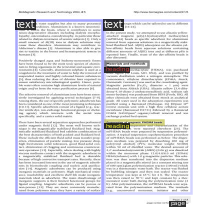

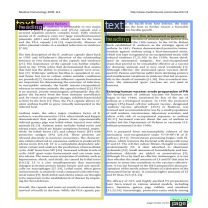

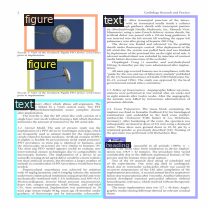

In [4]:
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [5]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [6]:
from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 1500 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 11 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[11/01 12:09:34 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_68b088.pkl: 421MB [00:17, 23.6MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (12, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (12,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (44, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (44,) in the model! You might want to double check if this is expected.


[11/01 12:09:58 d2.engine.train_loop]: Starting training from iteration 0
[11/01 12:10:35 d2.utils.events]:  eta: 0:46:17  iter: 19  total_loss: 6.286  loss_cls: 2.346  loss_box_reg: 0.884  loss_rpn_cls: 2.708  loss_rpn_loc: 0.331  time: 1.8831  data_time: 0.0282  lr: 0.000020  max_mem: 7236M
[11/01 12:11:14 d2.utils.events]:  eta: 0:47:24  iter: 39  total_loss: 3.261  loss_cls: 1.974  loss_box_reg: 0.830  loss_rpn_cls: 0.170  loss_rpn_loc: 0.260  time: 1.9127  data_time: 0.0136  lr: 0.000040  max_mem: 7236M
[11/01 12:11:55 d2.utils.events]:  eta: 0:47:39  iter: 59  total_loss: 2.436  loss_cls: 1.219  loss_box_reg: 0.763  loss_rpn_cls: 0.123  loss_rpn_loc: 0.198  time: 1.9633  data_time: 0.0165  lr: 0.000060  max_mem: 7236M
[11/01 12:12:38 d2.utils.events]:  eta: 0:47:41  iter: 79  total_loss: 2.045  loss_cls: 0.940  loss_box_reg: 0.842  loss_rpn_cls: 0.090  loss_rpn_loc: 0.173  time: 2.0056  data_time: 0.0122  lr: 0.000080  max_mem: 7236M
[11/01 12:13:18 d2.utils.events]:  eta: 0:47:0

In [7]:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [8]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [11/01 13:02:47 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/01 13:02:47 d2.data.datasets.coco]: Loaded 20 images in COCO format from /content/test/_annotations.coco.json
[11/01 13:02:47 d2.data.build]: Distribution of instances among all 11 categories:
|   category    | #instances   |  category  | #instances   |  category  | #instances   |
|:-------------:|:-------------|:----------:|:-------------|:----------:|:-------------|
| text-figure.. | 0            |   author   | 7            |  category  | 4            |
|    details    | 6            |   figure   | 5            |  heading   | 38           |
|     page      | 12           |   table    | 9            |    text    | 42           |
|     title     | 7            |    type    | 6            |            |              |
|     total     | 136          |            |              |            |              |
[11/01 13:02:47 d2.data.common]: Serializi

OrderedDict([('bbox',
              {'AP': 61.3993768577799,
               'AP-author': 60.396039603960396,
               'AP-category': 44.727722772277225,
               'AP-details': 84.66996699669967,
               'AP-figure': 77.24752475247524,
               'AP-heading': 39.56215086474336,
               'AP-page': 46.07882216793108,
               'AP-table': 73.63154172560114,
               'AP-text': 75.68330002414385,
               'AP-text-figure-table-title-heading': nan,
               'AP-title': 57.920792079207914,
               'AP-type': 54.07590759075909,
               'AP50': 90.40848240869465,
               'AP75': 67.09162836807823,
               'APl': 80.97627455482827,
               'APm': 44.594923778092095,
               'APs': 53.139716286560876})])

In [9]:
%ls ./output/

coco_instances_results.json                        last_checkpoint
events.out.tfevents.1604232576.41773cc998c1.244.0  metrics.json
instances_predictions.pth                          model_final.pth


In [10]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

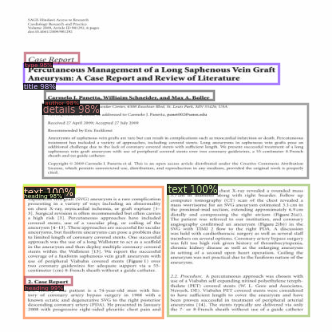

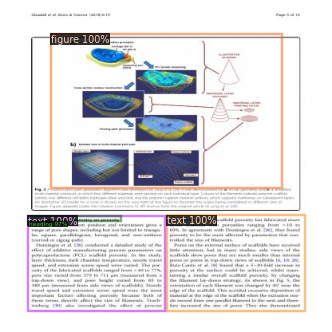

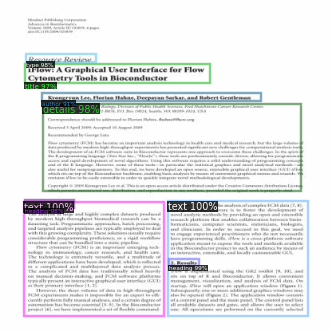

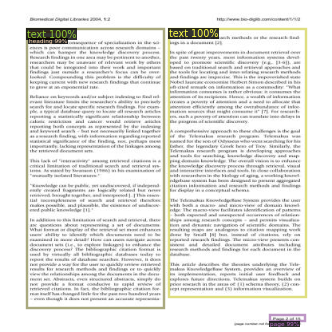

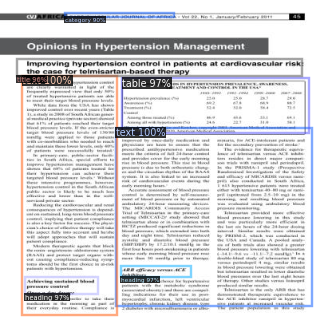

...

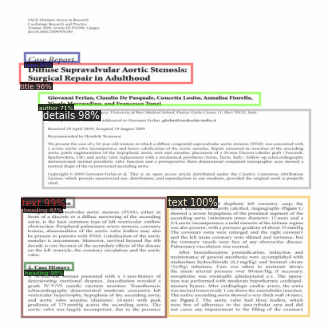

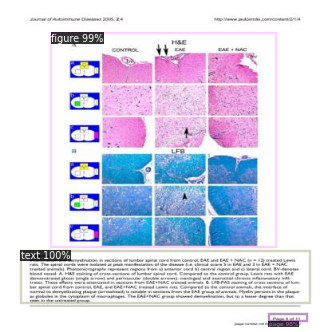

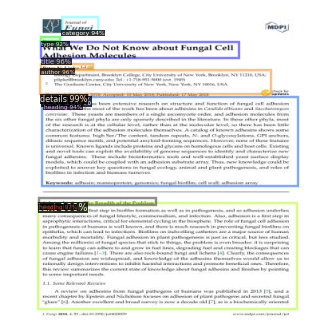

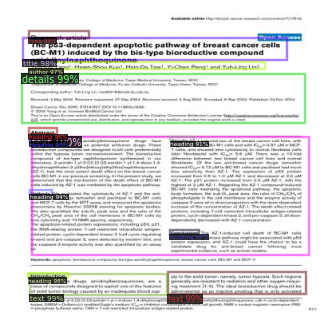

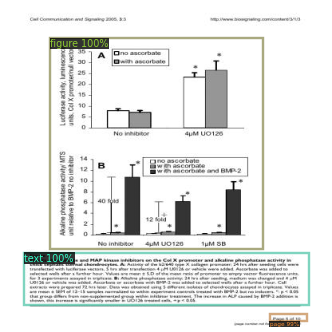

In [15]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/train/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
